In [ ]:
# %%
import os
import tensorflow as tf
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "2"
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, Activation, MaxPooling2D, UpSampling2D, Add
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import CategoricalCrossentropy
from sklearn.model_selection import train_test_split
import numpy as np
import cv2
from glob import glob
import matplotlib.pyplot as plt
import tensorflow.keras.backend as K


2024-12-02 18:26:46.223059: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-02 18:26:46.237439: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-02 18:26:46.241585: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-02 18:26:46.253559: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-02 18:26:47.038644: W tensorflow/compiler/tf2

In [8]:
# %%
# Define convolutional block
def conv_block(x, filters, kernel_size=(3, 3), stride=1, padding="same"):
    x = Conv2D(filters, kernel_size, strides=stride, padding=padding)(x)
    x = BatchNormalization()(x)
    x = Activation("relu")(x)
    return x

# Define residual block
def res_block(x, filters, stride=1):
    shortcut = x
    x = conv_block(x, filters, stride=stride)
    x = Conv2D(filters, (3, 3), padding="same")(x)
    x = BatchNormalization()(x)
    
    if stride != 1 or x.shape[-1] != filters:
        shortcut = Conv2D(filters, (1, 1), strides=stride, padding="same")(shortcut)
        shortcut = BatchNormalization()(shortcut)
    
    x = Add()([x, shortcut])
    x = Activation("relu")(x)
    return x

# Define model
def build_resnet50_for_segmentation(input_shape=(256, 256, 3), num_classes=4):
    inputs = Input(input_shape)

    # Encoder
    x = conv_block(inputs, 64, kernel_size=(7, 7), stride=2)
    x = MaxPooling2D(pool_size=(3, 3), strides=2, padding="same")(x)
    x = res_block(x, 64)
    x = res_block(x, 64)
    x = res_block(x, 64)

    x = res_block(x, 128, stride=2)
    x = res_block(x, 128)
    x = res_block(x, 128)
    x = res_block(x, 128)

    x = res_block(x, 256, stride=2)
    x = res_block(x, 256)
    x = res_block(x, 256)
    x = res_block(x, 256)
    x = res_block(x, 256)
    x = res_block(x, 256)

    x = res_block(x, 512, stride=2)
    x = res_block(x, 512)
    x = res_block(x, 512)

    # Decoder
    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(256, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(128, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(64, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(32, (3, 3), padding="same", activation="relu")(x)

    x = UpSampling2D(size=(2, 2))(x)
    x = Conv2D(num_classes, (1, 1), padding="same", activation="softmax")(x)  # Multi-class output

    return Model(inputs, x)


In [9]:
# %%
# Preprocess data
def preprocess_data(image_filenames, mask_filenames, target_size=(256, 256), num_classes=4):
    images, masks = [], []

    for img_path, mask_path in zip(image_filenames, mask_filenames):
        # Load and normalize image
        img = cv2.imread(img_path)
        img = cv2.resize(img, target_size) / 255.0

        # Load and process mask
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        mask = remap_mask_with_ranges(mask)
        mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        mask = tf.keras.utils.to_categorical(mask, num_classes=num_classes)

        images.append(img)
        masks.append(mask)

    return np.array(images), np.array(masks)

# Define mask remapping
def remap_mask_with_ranges(mask):
    remapped_mask = np.zeros_like(mask)

    # Define ranges
    background_range = (0, 50)       # Background
    gray_range = (70, 150)           # Putih keabu-abuan
    white_gray_range = (170, 230)    # Putih abu-abu
    white_range = (231, 255)         # Putih terang

    # Apply ranges
    remapped_mask[(mask >= background_range[0]) & (mask <= background_range[1])] = 0  # Background
    remapped_mask[(mask >= gray_range[0]) & (mask <= gray_range[1])] = 1  # Putih keabu-abuan
    remapped_mask[(mask >= white_gray_range[0]) & (mask <= white_gray_range[1])] = 2  # Putih abu-abu
    remapped_mask[(mask >= white_range[0]) & (mask <= white_range[1])] = 3  # Putih terang

    return remapped_mask


In [10]:
# %%
# Load dataset
image_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training/*'))  # Replace with your image paths
mask_filenames = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_training_gt/*'))  # Replace with your mask paths

# Split dataset into train and validation sets
image_train, image_val, mask_train, mask_val = train_test_split(
    image_filenames, mask_filenames, test_size=0.2, random_state=42
)

# Preprocess datasets
X_train, y_train = preprocess_data(image_train, mask_train, target_size=(256, 256), num_classes=4)
X_val, y_val = preprocess_data(image_val, mask_val, target_size=(256, 256), num_classes=4)


In [11]:
# %%
# IoU metric
def iou(y_true, y_pred):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)

    intersection = tf.reduce_sum(tf.cast(y_true * y_pred, tf.float32))
    union = tf.reduce_sum(tf.cast(y_true + y_pred, tf.float32)) - intersection
    iou = (intersection + K.epsilon()) / (union + K.epsilon())
    return iou

# Dice Coefficient metric
def dice_coefficient(y_true, y_pred):
    y_true = tf.argmax(y_true, axis=-1)
    y_pred = tf.argmax(y_pred, axis=-1)

    intersection = tf.reduce_sum(tf.cast(y_true * y_pred, tf.float32))
    dice = (2. * intersection + K.epsilon()) / (tf.reduce_sum(tf.cast(y_true, tf.float32)) +
                                                tf.reduce_sum(tf.cast(y_pred, tf.float32)) + K.epsilon())
    return dice


In [12]:
# %%
# Build and compile model
model = build_resnet50_for_segmentation(input_shape=(256, 256, 3), num_classes=4)
model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss=CategoricalCrossentropy(),
    metrics=["accuracy", iou, dice_coefficient]
)

# Define callbacks
callbacks_list = [
    EarlyStopping(monitor='val_iou', patience=10, restore_best_weights=True, mode='max'),
    ReduceLROnPlateau(monitor='val_iou', factor=0.2, patience=5, min_lr=1e-7, mode='max')
]


In [13]:
# Train the model
history = model.fit(
    X_train, y_train,
    validation_data=(X_val, y_val),
    epochs=50,
    callbacks=callbacks_list,
    batch_size=16
)


Epoch 1/50


I0000 00:00:1733139263.418852   72591 service.cc:146] XLA service 0x7f35080024d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1733139263.418908   72591 service.cc:154]   StreamExecutor device (0): NVIDIA GeForce RTX 4070 Ti, Compute Capability 8.9
2024-12-02 18:34:23.912514: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-12-02 18:34:25.623920: I external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:531] Loaded cuDNN version 8907


 3/33 ━━━━━━━━━━━━━━━━━━━━ 1s 47ms/step - accuracy: 0.6035 - dice_coefficient: 0.1094 - iou: 0.0601 - loss: 0.8962  

I0000 00:00:1733139276.020614   72591 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


33/33 ━━━━━━━━━━━━━━━━━━━━ 47s 623ms/step - accuracy: 0.8951 - dice_coefficient: 0.0285 - iou: 0.0155 - loss: 0.3116 - val_accuracy: 0.9625 - val_dice_coefficient: 3.2629e-12 - val_iou: 3.2629e-12 - val_loss: 0.3230 - learning_rate: 1.0000e-04
Epoch 2/50
33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 51ms/step - accuracy: 0.9705 - dice_coefficient: 1.3434 - iou: 3.3197 - loss: 0.0851 - val_accuracy: 0.9625 - val_dice_coefficient: 3.2629e-12 - val_iou: 3.2629e-12 - val_loss: 0.1365 - learning_rate: 1.0000e-04
Epoch 3/50
33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.9777 - dice_coefficient: 1.9541 - iou: -1338.0039 - loss: 0.0575 - val_accuracy: 0.9625 - val_dice_coefficient: 3.2629e-12 - val_iou: 3.2629e-12 - val_loss: 0.1342 - learning_rate: 1.0000e-04
Epoch 4/50
33/33 ━━━━━━━━━━━━━━━━━━━━ 2s 49ms/step - accuracy: 0.9827 - dice_coefficient: 2.0914 - iou: -4.1870 - loss: 0.0430 - val_accuracy: 0.9625 - val_dice_coefficient: 3.2629e-12 - val_iou: 3.2629e-12 - val_loss: 0.1582 - learning_rate: 1.0

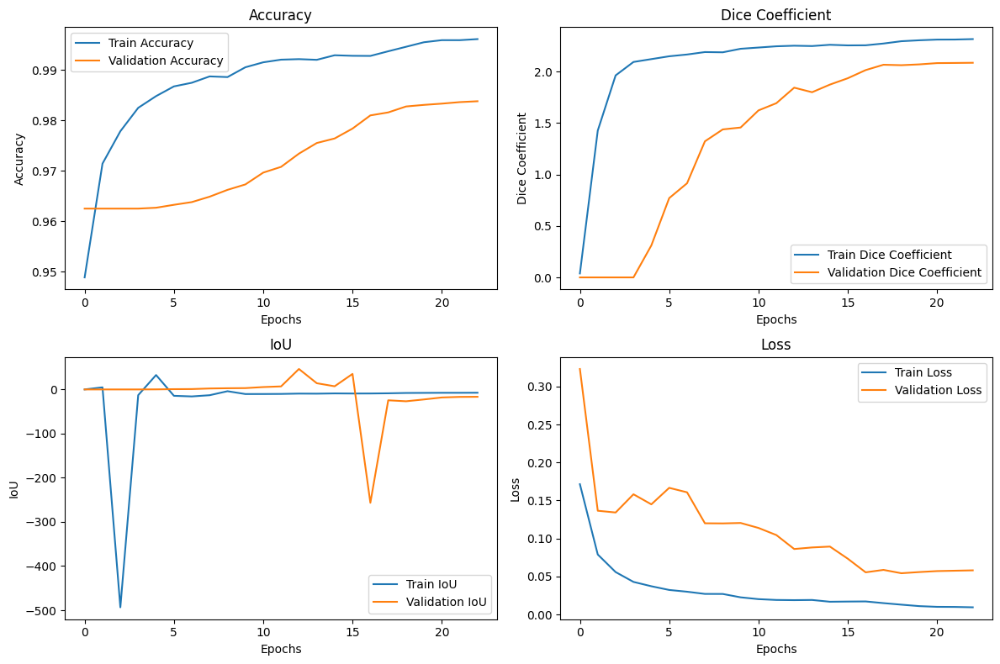

In [23]:
# %% 
# Extract metrics from history
history_dict = history.history

# %% 
# Plot accuracy and loss
plt.figure(figsize=(12, 8))

# Plot Accuracy
plt.subplot(2, 2, 1)
plt.plot(history_dict['accuracy'], label='Train Accuracy')
plt.plot(history_dict['val_accuracy'], label='Validation Accuracy')
plt.title('Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()

# Plot Dice Coefficient
plt.subplot(2, 2, 2)
plt.plot(history_dict['dice_coefficient'], label='Train Dice Coefficient')
plt.plot(history_dict['val_dice_coefficient'], label='Validation Dice Coefficient')
plt.title('Dice Coefficient')
plt.xlabel('Epochs')
plt.ylabel('Dice Coefficient')
plt.legend()

# Plot IoU (Intersection over Union)
plt.subplot(2, 2, 3)
plt.plot(history_dict['iou'], label='Train IoU')
plt.plot(history_dict['val_iou'], label='Validation IoU')
plt.title('IoU')
plt.xlabel('Epochs')
plt.ylabel('IoU')
plt.legend()

# Plot Loss
plt.subplot(2, 2, 4)
plt.plot(history_dict['loss'], label='Train Loss')
plt.plot(history_dict['val_loss'], label='Validation Loss')
plt.title('Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

In [17]:
# Fungsi untuk menghitung IoU dan Dice Coefficient untuk seluruh dataset test
def calculate_metrics(y_true, y_pred, num_classes=4):
    iou_list = []
    dice_list = []
    
    for i in range(len(y_true)):
        true_mask = np.argmax(y_true[i], axis=-1)  # Ambil label asli (ground truth) 
        pred_mask = np.argmax(y_pred[i], axis=-1)  # Ambil hasil prediksi

        # IoU
        intersection = np.sum(true_mask * pred_mask)
        union = np.sum(true_mask) + np.sum(pred_mask) - intersection
        iou = (intersection + 1e-6) / (union + 1e-6)
        iou_list.append(iou)

        # Dice Coefficient
        dice = (2 * intersection + 1e-6) / (np.sum(true_mask) + np.sum(pred_mask) + 1e-6)
        dice_list.append(dice)

    # Menghitung rata-rata
    mean_iou = np.mean(iou_list)
    mean_dice = np.mean(dice_list)
    
    return mean_iou, mean_dice

# %% 
# Fungsi untuk memproses data test dan melakukan prediksi
def preprocess_test_data(image_filenames, mask_filenames, target_size=(256, 256), num_classes=4):
    images, masks = [], []

    for img_path, mask_path in zip(image_filenames, mask_filenames):
        # Load and normalize image
        img = cv2.imread(img_path)
        img = cv2.resize(img, target_size) / 255.0

        # Load and process mask
        mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
        mask = remap_mask_with_ranges(mask)
        mask = cv2.resize(mask, target_size, interpolation=cv2.INTER_NEAREST)
        mask = tf.keras.utils.to_categorical(mask, num_classes=num_classes)

        images.append(img)
        masks.append(mask)

    return np.array(images), np.array(masks)

# Fungsi untuk remap mask berdasarkan rentang nilai (misal 4 kelas)
def remap_mask_with_ranges(mask):
    remapped_mask = np.zeros_like(mask)

    # Define ranges
    background_range = (0, 50)       # Background
    gray_range = (70, 150)           # Putih keabu-abuan
    white_gray_range = (170, 230)    # Putih abu-abu
    white_range = (231, 255)         # Putih terang

    # Apply ranges
    remapped_mask[(mask >= background_range[0]) & (mask <= background_range[1])] = 0  # Background
    remapped_mask[(mask >= gray_range[0]) & (mask <= gray_range[1])] = 1  # Putih keabu-abuan
    remapped_mask[(mask >= white_gray_range[0]) & (mask <= white_gray_range[1])] = 2  # Putih abu-abu
    remapped_mask[(mask >= white_range[0]) & (mask <= white_range[1])] = 3  # Putih terang

    return remapped_mask

In [20]:
# Load data test
image_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing/*'))
mask_filenames_test = sorted(glob('/home/khroos/work/Unet-Brain-MRI-Segmentation-Tensorflow-Keras/Cardiac_MRI_Dataset/es_testing_gt/*'))

# Preprocess data test
X_test, y_test = preprocess_test_data(image_filenames_test, mask_filenames_test, target_size=(256, 256), num_classes=4)

# Melakukan prediksi pada dataset test
predictions_test = model.predict(X_test)

8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step


In [21]:
# Menghitung nilai IoU dan Dice Coefficient pada dataset test
mean_iou, mean_dice = calculate_metrics(y_test, predictions_test, num_classes=4)

# Menampilkan hasil
print(f"Mean IoU: {mean_iou:.4f}")
print(f"Mean Dice Coefficient: {mean_dice:.4f}")

Mean IoU: 15.6357
Mean Dice Coefficient: 1.5493


8/8 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step


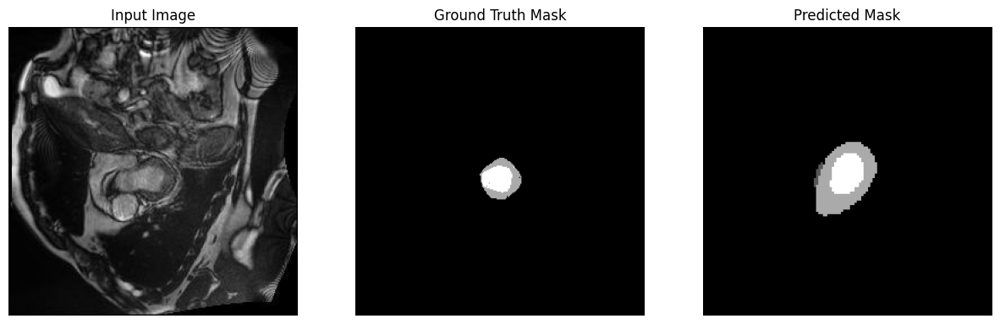

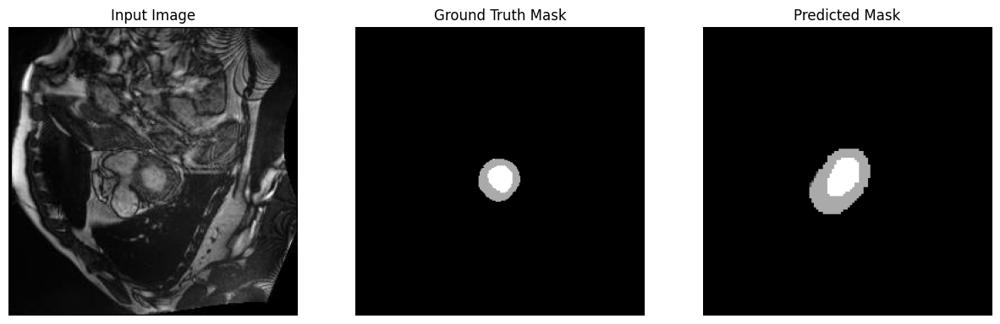

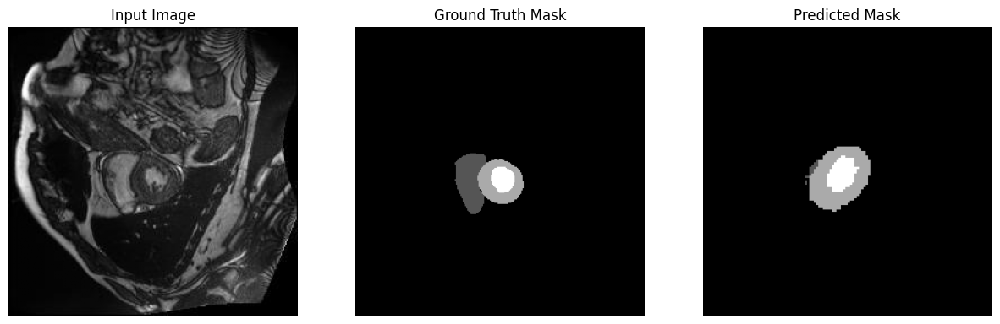

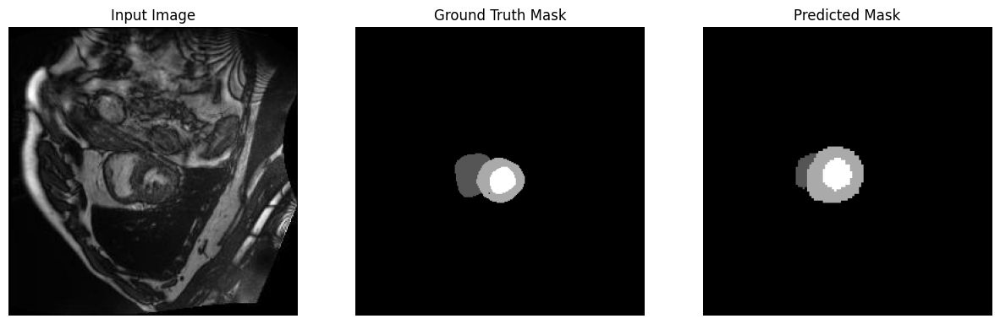

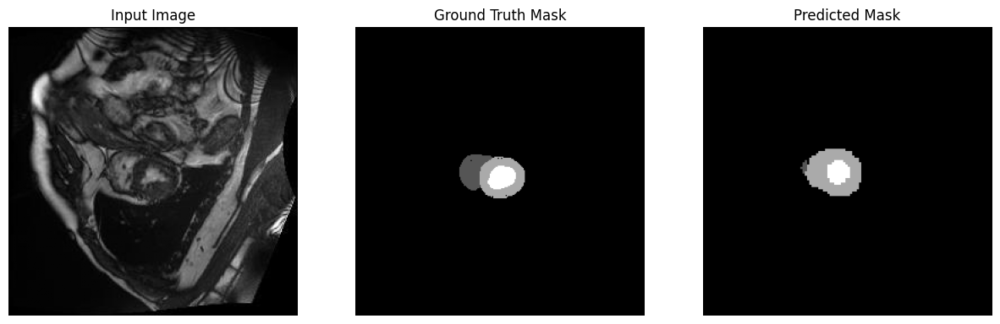

...

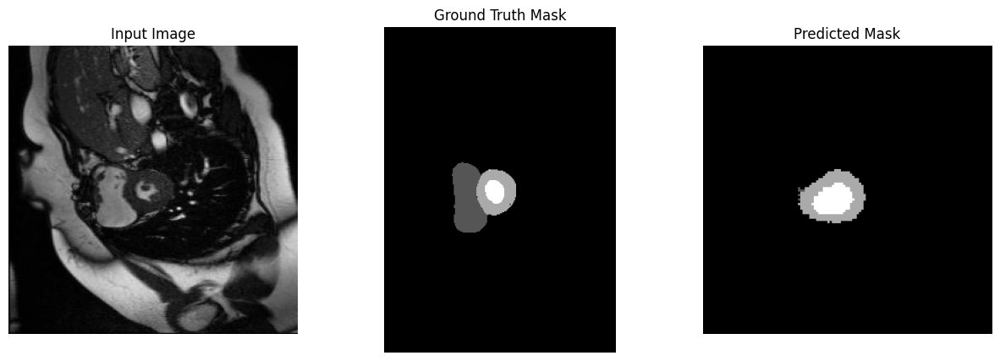

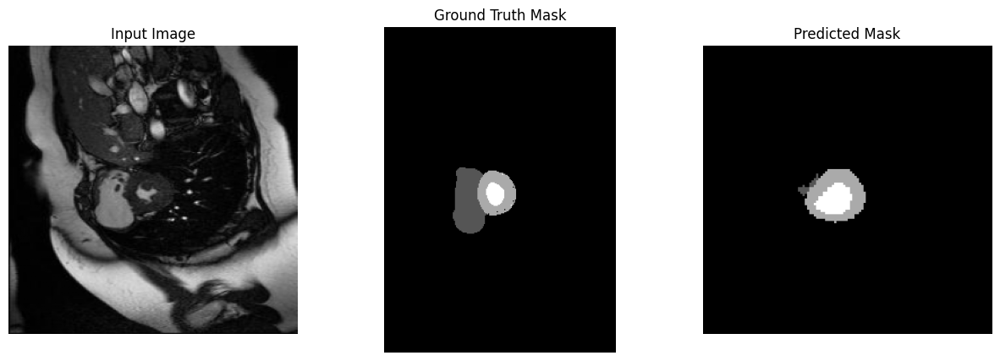

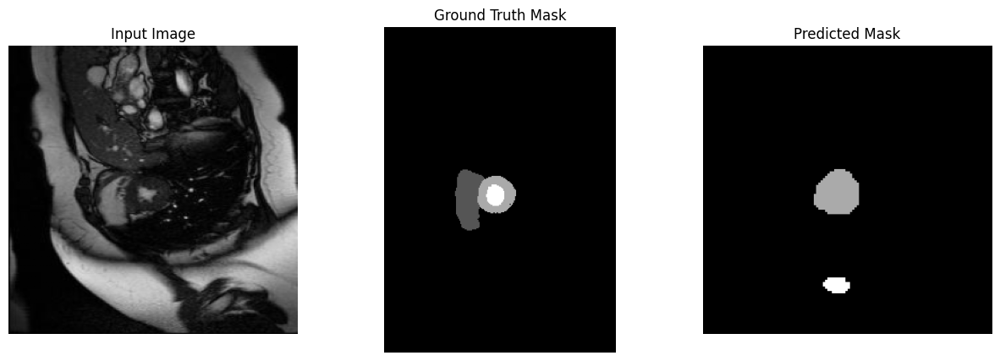

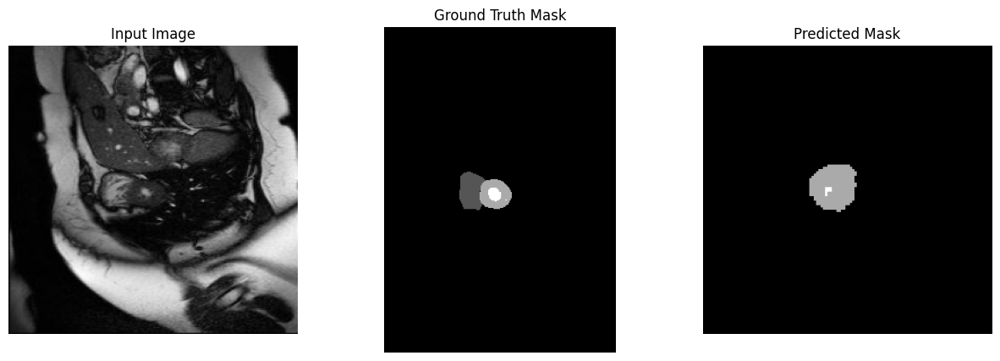

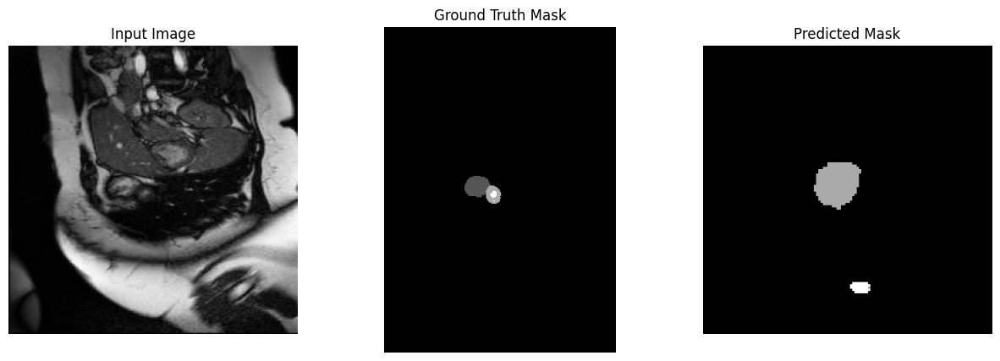

In [22]:
# %% 
# Fungsi untuk visualisasi hasil prediksi pada data test (tanpa num_samples)
def visualize_predictions(model, X_test, mask_filenames, target_size=(256, 256)):
    predictions = model.predict(X_test)

    # Menampilkan semua gambar dan prediksi
    for i in range(len(X_test)):
        img = X_test[i]
        ground_truth = cv2.imread(mask_filenames[i], cv2.IMREAD_GRAYSCALE)
        ground_truth = remap_mask_with_ranges(ground_truth)
        predicted_mask = np.argmax(predictions[i], axis=-1)

        # Menampilkan hasil visualisasi
        plt.figure(figsize=(15, 5))

        # Gambar Input
        plt.subplot(1, 3, 1)
        plt.title("Input Image")
        plt.imshow(img)
        plt.axis("off")

        # Mask Ground Truth
        plt.subplot(1, 3, 2)
        plt.title("Ground Truth Mask")
        plt.imshow(ground_truth, cmap="gray")
        plt.axis("off")

        # Prediksi Mask
        plt.subplot(1, 3, 3)
        plt.title("Predicted Mask")
        plt.imshow(predicted_mask, cmap="gray")
        plt.axis("off")

        # Menampilkan plot
        plt.show()

# %% 
# Visualisasi hasil prediksi pada dataset test
visualize_predictions(model, X_test, mask_filenames_test)
